# Gradient descent

Gradient descent (GD) is an iterative optimization algorithm used to find the minimum of a function. It's very generic (works for any loss function), therefore widely used in machine learning for training models by minimizing a loss function.

## What is Gradient Descent?

Imagine you're standing on a mountainside in thick fog, and you want to reach the lowest point in the valley. You can't see very far, but you can feel which way the ground slopes beneath your feet. The sensible strategy is to take a step in the direction that goes downhill the steepest. You repeat this process, and eventually, you'll reach a valley (hopefully the lowest one!). This is the essence of gradient descent.

## The Mathematics

In mathematical terms, we want to minimize a function $f(\theta)$, where $\theta$ represents our parameters (e.g., weights in a model). In the previous lecture, we use $\beta$ to represent the parameters. The gradient descent algorithm works as follows:

1. **Start** with an initial guess $\theta_0$
2. **Compute** the gradient (derivative) of the function at the current point: $\nabla f(\theta_t)$
3. **Update** the parameters by moving in the opposite direction of the gradient:
$$
   \theta_{t+1} = \theta_t - \alpha \nabla f(\theta_t)
$$
4. **Repeat** steps 2-3 until convergence

The gradient $\nabla f(\theta)$ tells us the direction of steepest **ascent**, so we move in the **negative** direction to descend.

## Key Concepts

### Learning Rate ($\alpha$)
The learning rate controls how big of a step we take at each iteration:
- **Too small**: The algorithm will converge very slowly, requiring many iterations
- **Too large**: The algorithm might overshoot the minimum and fail to converge, or even diverge
- **Just right**: The algorithm converges efficiently to the minimum

### Convergence
We stop the algorithm when:
- The change in loss between iterations is below some threshold
- The change in parameters is below some threshold
- We've reached a maximum number of iterations

### Local vs. Global Minima
- **Convex functions** (like linear regression with MSE loss): Have a single global minimum. Gradient descent will find it regardless of initialization.
- **Non-convex functions** (like neural networks): May have multiple local minima. The final solution depends on initialization and learning rate.

In [1]:
%matplotlib inline
from typing import Callable

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import statsmodels.formula.api as smf

from matplotlib import animation, cm
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

sns.set_theme(font_scale=1.5)
sns.set_style("whitegrid", {"grid.linestyle": "--"})

## Linear Regression Example

Let's apply gradient descent to the previously studied linear regression problem, where the loss function is the mean squared errors (MSE):

$$
f(\theta) = L(\beta_0, \beta_1) = \frac{1}{n} \sum_{i=1}^{n} (y_i - (\beta_0 + \beta_1 x_i))^2
$$

Where:
- $ \beta_0 $ is the intercept
- $ \beta_1 $ is the slope
- $ \theta = [\beta_0, \beta_1]^{T} \in \mathbb{R}^{2 \times 1} $ is the vector representing the parameters
- $ (x_i $, $ y_i) $ is the $i$-th data point

For this specific problem, we can use the normal equation to find the closed-form solution for the parameters. However, we will use gradient descent to illustrate the optimization process, and hopefully arriving at the same solution. The gradients for this problem are:

$$
\frac{\partial L}{\partial \beta_0} = - \frac{2}{n} \sum_{i=1}^{n} (y_i - (\beta_0 + \beta_1 x_i))
$$

$$
\frac{\partial L}{\partial \beta_1} = - \frac{2}{n} \sum_{i=1}^{n} x_i(y_i - (\beta_0 + \beta_1 x_i))
$$

In vector form, the gradient can be expressed compactly as:

$$
\nabla f(\theta) = \begin{bmatrix} \frac{\partial L}{\partial \beta_0} \\ \frac{\partial L}{\partial \beta_1} \end{bmatrix} = - \frac{2}{n} X^T (y - X\theta)
$$

where $X$ is the $n \times 2$ matrix (with first column of ones for the intercept), and $y$ is the vector of target values.

Let's first use the Auto MPG dataset to fit a simple linear regression model using the normal equation.

In [2]:
auto = pd.read_csv("https://raw.githubusercontent.com/changyaochen/MECE4520/master/data/auto_mpg.csv")
# drop the null values
auto.dropna(inplace=True)

# simple linear regression with the `statsmodels` library
auto_model = smf.ols(formula='mpg ~ horsepower', data=auto)
auto_result = auto_model.fit()
print(f"The intercept is {auto_result.params.iloc[0]:5.4f}, and the slope is {auto_result.params.iloc[1]:5.4f}")

The intercept is 39.9359, and the slope is -0.1578


Let's define the loss function, which takes the dependent variables, independent variables, and the model parameters (intercpet and slope) as inputs.

In [3]:
def linear_regression_loss(
    X: np.ndarray,
    y: np.ndarray,
    betas: np.ndarray | list | tuple,
    normalized: bool = True,
) -> float:
    """Calculates the loss of a linear regression problem.

    Args:
        X: The array (matrix) that contains the independent variables. By convention, the shape is n by (d+1).
        y: The array (column vector) that contains the dependent variable. The shape is n by 1.
        betas: The array that contains the coefficients. The shape is (d+1) by 1.
        normalized: If True, the loss function is normalized by sample sizes (i.e., n).

    Returns:
        (float): The loss function value.

    Raises:
        AssertionError: If the shape of the predicted value is different from y.
    """
    if not isinstance(betas, np.ndarray):
        betas = np.array(betas).reshape(-1, 1)
    if y.ndim == 1:
        y = y.reshape(-1, 1)

    y_pred = X @ betas
    assert y.shape == y_pred.shape, f"y has shape of {y.shape} and y_pred of {y_pred.shape}"
    loss = np.sum(np.square(y - X @ betas))

    if normalized:
        loss /= len(y)

    return loss

X_auto = np.column_stack((np.ones(len(auto)), auto["horsepower"].values))
y_auto = np.array(auto["mpg"].values).reshape(-1, 1)

# test run
auto_betas = [50, -0.2]
auto_loss = linear_regression_loss(X=X_auto, y=y_auto, betas=auto_betas)
print(f"The loss is {auto_loss:,.2f}")

The loss is 58.61


### A simple example with just one parameter

Next we will visualize the loss function, by fixing the slope, but only varying the value of intercept. We should see the loss function follows a parabola shape.

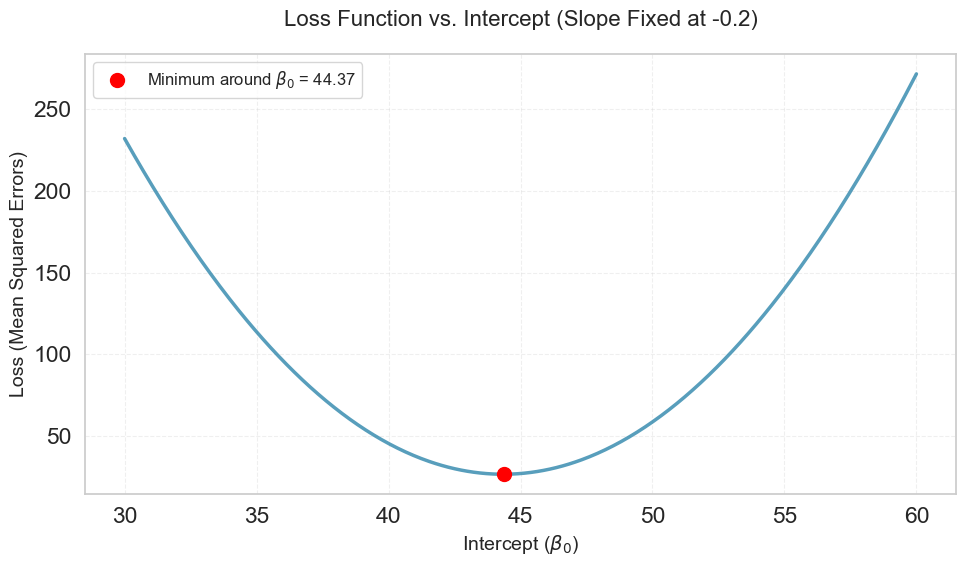

In [4]:
# fix beta_1, i.e., slope
auto_slope = -0.2
auto_losses = []
auto_beta_0s = np.linspace(start=30, stop=60, num=500)
for b in auto_beta_0s:
    auto_betas = np.array([b, auto_slope]).reshape(-1, 1)
    loss = linear_regression_loss(X=X_auto, y=y_auto, betas=auto_betas)
    auto_losses.append(loss)

# plot the loss function
plt.figure(figsize=(10, 6))
plt.plot(auto_beta_0s, auto_losses, linewidth=2.5, color="#2E86AB", alpha=0.8)
plt.xlabel("Intercept ($\\beta_0$)", fontsize=14)
plt.ylabel("Loss (Mean Squared Errors)", fontsize=14)
plt.title("Loss Function vs. Intercept (Slope Fixed at -0.2)", fontsize=16, pad=20)
plt.grid(True, alpha=0.3, linestyle="--", linewidth=0.8)

# Optionally mark the minimum
min_idx = np.argmin(auto_losses)
plt.scatter(
    auto_beta_0s[min_idx], auto_losses[min_idx],
    color="red", s=100, zorder=5, label=f"Minimum around $\\beta_0$ = {auto_beta_0s[min_idx]:.2f}"
)
plt.legend(fontsize=12)

plt.tight_layout()
plt.show()

We have defined the gradient of the loss function for linear regression, in below we will define the gradient function.

In [5]:
def linear_regression_loss_gradient(
    X: np.ndarray,
    y: np.ndarray,
    betas: np.ndarray | list | tuple,
    normalized: bool = True,
) -> np.ndarray:
    """Calculates the gradient of the loss of a linear regression problem.

    Args:
        X: The array (matrix) that contains the independent variables. By convention, the shape is n by (d+1).
        y: The array (column vector) that contains the dependent variable. The shape is n by 1.
        betas: The array that contains the coefficients. The shape is (d+1) by 1.
        normalized: If True, the gradient is normalized by sample sizes (i.e., n).

    Returns:
        (float): The value of the gradient.
    """
    if not isinstance(betas, np.ndarray):
        betas = np.array(betas).reshape(-1, 1)
    if y.ndim == 1:
        y = y.reshape(-1, 1)

    grad = -2 * (X.T @ (y - X @ betas))
    assert grad.shape == betas.shape, f"The shape of grad is {grad.shape} and betas is {betas.shape}"
    if normalized:
        grad /= len(y)

    return grad

Finally, let's construct the GD routine, by using the previously defined loss function, and the gradient function.

In [6]:
from numpy.typing import ArrayLike


def gradient_descent(
    X: np.ndarray,
    y: np.ndarray,
    initial_guess: np.ndarray | list | tuple,
    learning_rate: float,
    loss_function: Callable,
    gradient_function: Callable,
    verbose: bool = False,
    threshold: float = 1e-6,
    fix_guess: dict | None = None,
) -> tuple[ArrayLike, ArrayLike]:
    """Gradient descent routine.

    Here we use the absolute value of different in loss as the convergence criterion.

    Args:
        X: The input data without labels.
        y: The labels.
        initial_guess: The starting point of the gradient descent.
        learning_rate: The learning rate of the gradient descent.
        loss_function: Provided loss function, that takes (X, y, parameter) as inputs.
        gradient_function: Provided gradient of the loss function, that takes (X, y, parameter) as inputs.
        verbose: If set to True, print out intermediate results.
        threshold: Absolute value of different in loss, below which is considered converged.
        fix_guess: A dictionary to fix given dimension(s) of the parameter.
            For example, if the parameter is a 2x1 vector, and we want to fix the first parameter to value 1.5,
            the fix_guess should be {0: 1.5}.

    Return:
        ArrayLike: The history of parameters.
        ArrayLike: The history of the losses.
    """
    parameter_current = np.array(initial_guess).reshape(-1, 1)
    if fix_guess:
        for k, v in fix_guess.items():
            parameter_current[k] = v

    parameter_history = [parameter_current.flatten().tolist()]
    loss_history = [loss_function(X=X, y=y, betas=parameter_current)]

    difference = float("inf")
    iteration_count = 0
    while abs(difference) > threshold:
        iteration_count += 1
        parameter_next = parameter_current - learning_rate * gradient_function(
            X=X, y=y, betas=parameter_current)
        if fix_guess:
            for k, v in fix_guess.items():
                parameter_next[k] = v
        parameter_history.append(parameter_next.flatten().tolist())

        loss_next = loss_function(X=X, y=y, betas=parameter_next)
        difference = loss_next - loss_history[-1]
        loss_history.append(loss_next)

        # update guess
        parameter_current = parameter_next
        # to print out intermediate results
        if verbose and iteration_count % 1000 == 0:
            print(f"The loss is {loss_next:5.3f}, and the parameters are {parameter_next.flatten()}, ")

    # some datatype processing
    parameter_history = [list(np.array(x).flatten()) for x in parameter_history]
    print(f"\nTotal number of iterations: {iteration_count:,}")
    print(f"The final parameters are: {parameter_history[-1]}")

    return parameter_history, loss_history

In [7]:
auto_parameter_history, auto_loss_history = gradient_descent(
    X=X_auto,
    y=y_auto,
    initial_guess=[60, -0.2],
    learning_rate=1e-4,
    loss_function=linear_regression_loss,
    gradient_function=linear_regression_loss_gradient,
    verbose=True,
    threshold=1e-4,
    fix_guess={1: -0.2}  # Fix the slope to -0.2
)

The loss is 190.954, and the parameters are [57.16103014 -0.2       ], 
The loss is 136.755, and the parameters are [54.8367247 -0.2      ], 
The loss is 100.426, and the parameters are [52.93378242 -0.2       ], 
The loss is 76.075, and the parameters are [51.37581622 -0.2       ], 
The loss is 59.753, and the parameters are [50.10028689 -0.2       ], 
The loss is 48.812, and the parameters are [49.05599269 -0.2       ], 
The loss is 41.479, and the parameters are [48.20101402 -0.2       ], 
The loss is 36.563, and the parameters are [47.50103069 -0.2       ], 
The loss is 33.268, and the parameters are [46.92794427 -0.2       ], 
The loss is 31.060, and the parameters are [46.45875018 -0.2       ], 
The loss is 29.579, and the parameters are [46.07461424 -0.2       ], 
The loss is 28.587, and the parameters are [45.76011662 -0.2       ], 
The loss is 27.922, and the parameters are [45.50263289 -0.2       ], 
The loss is 27.476, and the parameters are [45.29182727 -0.2       ], 
The l

### Animated Visualization

Let's create an animation to see how gradient descent iteratively updates the intercept to minimize the loss function. This gives us a better intuition of the optimization process.

In [8]:
# Create animation for 1D gradient descent
# This visualizes how gradient descent iteratively moves toward the minimum

# Set up the figure and axis
fig, ax = plt.subplots(figsize=(10, 6))

# Plot the loss function curve (the landscape we're optimizing over)
line_loss, = ax.plot(auto_beta_0s, auto_losses, "b-", alpha=0.8, linewidth=2, label="Loss function")

# Initialize the animated elements
point, = ax.plot([], [], "ro", markersize=12, label="Current position")  # Red dot for current position
trail, = ax.plot([], [], "r--", alpha=0.95, linewidth=1, label="Path")    # Dashed line showing path taken

# Configure plot appearance
ax.set_xlabel("Intercept ($\\beta_0$)")
ax.set_ylabel("Loss")
ax.set_title("Gradient Descent Animation (1D)")
ax.legend()
ax.grid(True, alpha=0.3)

# Store trail points for visualization (accumulated across animation frames)
trail_x: list[float] = []
trail_y: list[float] = []

def init() -> tuple[plt.Line2D, plt.Line2D]:
    """Initializes the animation by clearing all animated elements.

    This function is called once at the beginning of the animation to set up
    the initial state of all animated objects.

    Returns:
        Tuple of animated Line2D objects (point, trail).
    """
    point.set_data([], [])
    trail.set_data([], [])
    return point, trail

def animate(frame: int, parameter_history: ArrayLike, loss_history: ArrayLike) -> tuple[plt.Line2D, plt.Line2D]:
    """Updates the animation for each frame.

    This function is called for each frame of the animation. It updates the
    position of the current point and extends the trail to show the path
    taken by gradient descent.

    Args:
        frame: The current frame index in the animation sequence.

    Returns:
        Tuple of updated Line2D objects (point, trail).
    """
    if frame < len(parameter_history):
        # Extract current parameter value and corresponding loss
        x = parameter_history[frame][0]  # Current intercept value
        y = loss_history[frame]     # Current loss value

        # Add current position to trail history
        trail_x.append(x)
        trail_y.append(y)

        # Update the current position marker
        point.set_data([x], [y])

        # Update the trail showing all positions visited so far
        trail.set_data(trail_x, trail_y)

        # Update title to show progress information
        ax.set_title(f"Gradient Descent Animation (1D) - Iteration {frame}/{len(parameter_history)-1}")

    return point, trail

# Create the animation
anim = FuncAnimation(
    fig,
    animate,
    init_func=init,
    fargs=(auto_parameter_history, auto_loss_history),
    frames=range(0, len(auto_parameter_history), max(1, len(auto_parameter_history) // 200)),  # Frame indices to animate
    interval=50,  # Milliseconds between frames (50ms = 20 fps)
    blit=True,  # Use blitting for better performance
    repeat=True  # Loop the animation
)

plt.close()  # Prevent duplicate display in notebook
HTML(anim.to_jshtml())  # Render as interactive HTML5 animation

### General case with multiple parameters

In the previous example, we fixed the slope and only varied the intercept to visualize the optimization in one dimension. Now let's optimize **both** the intercept and slope simultaneously, as it is what we should do in the real case.

When we have two parameters, the loss function becomes a surface in 3D space (instead of a curve), and gradient descent navigates this surface to find the lowest point. The gradient now has two components:

$$
\nabla f(\theta) = \nabla L(\beta_0, \beta_1) = \begin{bmatrix} \frac{\partial L}{\partial \beta_0} \\ \frac{\partial L}{\partial \beta_1} \end{bmatrix}
$$

This gradient vector points in the direction of steepest ascent on the surface, and we move in the opposite direction. 

In [9]:
def plot_loss_surface_3d(
    X: np.ndarray,
    y: np.ndarray,
    loss_function: Callable,
    param_ranges: tuple[tuple[float, float], tuple[float, float]],
    param_names: list[str] = ["parameter_1", "parameter_2"],
    true_minimum: list[float] | None = None,
    grid_size: int = 100
) -> tuple[np.ndarray, np.ndarray, np.ndarray]:
    """Plots an interactive 3D loss surface using Plotly.

    This function computes and visualizes the loss landscape over a 2D parameter space,
    which is useful for understanding the optimization problem and verifying gradient
    descent convergence.

    Args:
        X: The design matrix. Shape: (n_samples, n_features).
        y: The target values. Shape: (n_samples,) or (n_samples, 1).
        loss_function: Function that computes loss, with signature f(X, y, betas).
        param_ranges: Tuple of ((min_param0, max_param0), (min_param1, max_param1))
            defining the parameter space to visualize.
        param_names: Names of the two parameters for axis labels.
        true_minimum: Optional [param0, param1] values of the true minimum to mark.
        grid_size: Number of grid points along each parameter dimension. Default: 100.

    Returns:
        Tuple of (param0_grid, param1_grid, loss_grid) containing the meshgrid
        coordinates and computed losses. These can be reused for trajectory plotting.
    """
    import plotly.graph_objects as go

    # Create parameter grids
    param_1_range = np.linspace(param_ranges[0][0], param_ranges[0][1], grid_size)
    param_2_range = np.linspace(param_ranges[1][0], param_ranges[1][1], grid_size)
    param_1_grid, param_2_grid = np.meshgrid(param_1_range, param_2_range)

    # Vectorized computation of losses
    params = np.column_stack([param_1_grid.ravel(), param_2_grid.ravel()])
    losses = np.array([loss_function(X=X, y=y, betas=p.reshape(-1, 1)) for p in params])
    loss_grid = losses.reshape(grid_size, grid_size)

    # Compute true minimum loss if provided
    true_loss = None
    if true_minimum is not None:
        true_loss = loss_function(X=X, y=y, betas=true_minimum)
        print(f"True minimum loss: {true_loss:,.3f}")

    # Create interactive Plotly figure
    fig = go.Figure()

    # Add loss surface with contours
    fig.add_trace(go.Surface(
        x=param_1_grid,
        y=param_2_grid,
        z=loss_grid,
        colorscale="RdYlBu_r",
        opacity=0.8,
        name="Loss Surface",
        colorbar=dict(title="Loss", x=1.1),
        contours=dict(
            z=dict(show=True, usecolormap=True, highlightcolor="limegreen", project=dict(z=True))
        ),
        hovertemplate=f"{param_names[0]}: %{{x:.4f}}<br>{param_names[1]}: %{{y:.6f}}<br>Loss: %{{z:,.2f}}<extra></extra>"
    ))

    # Mark true minimum if provided
    if true_minimum is not None and true_loss is not None:
        fig.add_trace(go.Scatter3d(
            x=[true_minimum[0]],
            y=[true_minimum[1]],
            z=[true_loss],
            mode="markers",
            marker=dict(size=10, color="black", symbol="diamond", line=dict(color="white", width=2)),
            name=f"True Min<br>{param_names[0]}={true_minimum[0]:.2f}, {param_names[1]}={true_minimum[1]:.4f}",
            hovertemplate=f"<b>True Minimum</b><br>{param_names[0]}: %{{x:.4f}}<br>{param_names[1]}: %{{y:.6f}}<br>Loss: %{{z:,.2f}}<extra></extra>"
        ))

    # Update layout
    fig.update_layout(
        title=dict(
            text="Loss Surface<br><sub>Interactive 3D Visualization (Drag to Rotate)</sub>",
            x=0.5,
            xanchor="center"
        ),
        scene=dict(
            xaxis=dict(title=f"{param_names[0]}", backgroundcolor="rgb(230, 230, 230)"),
            yaxis=dict(title=f"{param_names[1]}", backgroundcolor="rgb(230, 230, 230)"),
            zaxis=dict(title="Loss", backgroundcolor="rgb(230, 230, 230)"),
            camera=dict(eye=dict(x=1.5, y=1.5, z=1.3))
        ),
        width=1200,
        height=900,
        showlegend=True
    )

    fig.show()

    return param_1_grid, param_2_grid, loss_grid

beta_0_grid, beta_1_grid, auto_losses_2d = plot_loss_surface_3d(
    X=X_auto,
    y=y_auto,
    loss_function=linear_regression_loss,
    param_ranges=((30, 60), (-0.3, -0.1)),
    param_names=["Intercept", "Slope"],
    true_minimum=[39.9359, -0.1578]
)

True minimum loss: 23.944


In [10]:
# gradient descent with both intercept and slope
# with the following setting, it can take a few seconds to converge
auto_parameter_history, auto_loss_history = gradient_descent(
    X=X_auto,
    y=y_auto,
    initial_guess=[50, -0.1],
    learning_rate=1e-5,
    loss_function=linear_regression_loss,
    gradient_function=linear_regression_loss_gradient,
    verbose=True,
    threshold=1e-7,
)

The loss is 35.962, and the parameters are [49.97482585 -0.24248037], 
The loss is 35.905, and the parameters are [49.95091172 -0.24227876], 
The loss is 35.848, and the parameters are [49.92705456 -0.24207763], 
The loss is 35.792, and the parameters are [49.90325423 -0.24187697], 
The loss is 35.735, and the parameters are [49.87951059 -0.2416768 ], 
The loss is 35.679, and the parameters are [49.85582351 -0.2414771 ], 
The loss is 35.623, and the parameters are [49.83219286 -0.24127787], 
The loss is 35.568, and the parameters are [49.8086185  -0.24107913], 
The loss is 35.512, and the parameters are [49.7851003  -0.24088085], 
The loss is 35.457, and the parameters are [49.76163812 -0.24068305], 
The loss is 35.403, and the parameters are [49.73823183 -0.24048572], 
The loss is 35.348, and the parameters are [49.7148813  -0.24028885], 
The loss is 35.294, and the parameters are [49.69158639 -0.24009246], 
The loss is 35.240, and the parameters are [49.66834697 -0.23989654], 
The lo

### Visualize 2D Gradient Descent

Now let's create an animation showing how gradient descent navigates the 2D loss surface. We'll show both a 3D view and a contour (top-down) view side by side.


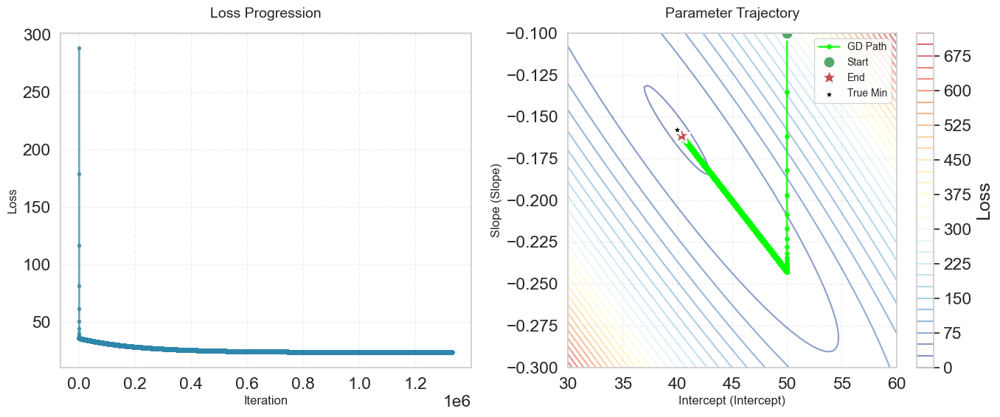

In [ ]:
def plot_gradient_descent_progress(
    losses: list[float] | ArrayLike,
    params_history: list[list[float]] | ArrayLike,
    param_names: list[str] = ["parameter_1", "parameter_2"],
    true_minimum: list[float] | None = None,
    loss_contours: tuple[np.ndarray, np.ndarray, np.ndarray] | None = None
) -> None:
    """Plots gradient descent progress showing loss and parameter trajectory.

    Args:
        losses: List of loss values at each iteration.
        params_history: List of parameter values at each iteration, shape [n_iter, n_params].
        param_names: Names of the parameters for axis labels.
        true_minimum: Optional true minimum point [param0, param1] to mark on plot.
        loss_contours: Optional tuple of (X, Y, Z) for contour plot background.
            X, Y are meshgrids, Z is the loss surface.
    """
    params_array = np.array(params_history)

    fig, axes = plt.subplots(1, 2, figsize=(14, 6))

    # Left plot: Loss progression
    axes[0].plot(losses, linewidth=2, color="#2E86AB", marker="o", markersize=3, alpha=0.7)
    axes[0].set_xlabel("Iteration", fontsize=12)
    axes[0].set_ylabel("Loss", fontsize=12)
    axes[0].set_title("Loss Progression", fontsize=14, pad=15)
    axes[0].grid(True, alpha=0.3, linestyle="--")


    # Right plot: Parameter trajectory
    if loss_contours is not None:
        X, Y, Z = loss_contours
        contour = axes[1].contour(X, Y, Z, levels=30, cmap="RdYlBu_r", alpha=0.6)
        plt.colorbar(contour, ax=axes[1], label="Loss")

    # Plot trajectory
    axes[1].plot(
        params_array[:, 0], params_array[:, 1],
        "o-", linewidth=2, markersize=4, color="lime", alpha=0.8, label="GD Path"
    )

    # Mark start and end
    axes[1].plot(
        params_array[0, 0], params_array[0, 1],
        "go", markersize=12, markeredgecolor="white", markeredgewidth=2, label="Start"
    )
    axes[1].plot(
        params_array[-1, 0], params_array[-1, 1],
        "r*", markersize=18, markeredgecolor="white", markeredgewidth=2, label="End"
    )

    # Mark true minimum if provided
    if true_minimum is not None:
        axes[1].scatter(
            [true_minimum[0]], [true_minimum[1]],
            s=150, marker="*", color="black", edgecolors="white", linewidths=2,
            label="True Min", zorder=5
        )

    axes[1].set_xlabel(f"{param_names[0]}", fontsize=12)
    axes[1].set_ylabel(f"{param_names[1]}", fontsize=12)
    axes[1].set_title("Parameter Trajectory", fontsize=14, pad=15)
    axes[1].legend(fontsize=10, loc="best")
    axes[1].grid(True, alpha=0.3, linestyle="--")

    plt.tight_layout()
    plt.show()

true_minimum_auto = [39.9359, -0.1578]
plot_gradient_descent_progress(
    losses=auto_loss_history,
    params_history=auto_parameter_history,
    param_names=["Intercept", "Slope"],
    true_minimum=true_minimum_auto,
    loss_contours=(beta_0_grid, beta_1_grid, auto_losses_2d)
)

## Logistic Regression Example

Now let's apply gradient descent to logistic regression, where the loss function is the **cross-entropy loss**. Unlike linear regression, logistic regression **does not have a closed-form solution**, making gradient descent essential for finding the optimal parameters.

### The Logistic Regression Model

For binary classification, the logistic regression model predicts the probability that an instance belongs to class 1. 
If we only consider one feature $x$ (so that we can visualize it in 2D), the model is given by:

$$
P(y=1|x) = \sigma(\beta_0 + \beta_1 x) = \frac{1}{1 + e^{-(\beta_0 + \beta_1 x)}}
$$

Where $ \sigma(z) $ is the sigmoid function.

### Cross-Entropy Loss

The loss function we minimize is the negative log-likelihood (cross-entropy):

$$
f(\theta) = L(\beta_0, \beta_1) = -\sum_{i=1}^{n} \left[ y_i \log(\hat{y}_i) + (1-y_i) \log(1-\hat{y}_i) \right]
$$

Where $\hat{y}_i = \sigma(\beta_0 + \beta_1 x_i)$ is the predicted probability of being in class 1. 
As before, we use $\theta = [\beta_0, \beta_1]^T$ to denote the parameters.

### Gradients for Logistic Regression

The gradients have a remarkably simple form:

$$
\frac{\partial L}{\partial \beta_0} = -\sum_{i=1}^{n} (y_i - \hat{y}_i)
$$

$$
\frac{\partial L}{\partial \beta_1} = -\sum_{i=1}^{n} x_i(y_i - \hat{y}_i)
$$

Notice the similarity to linear regression! The difference is that $ \hat{y}_i $ is now the sigmoid of the linear prediction, not the linear prediction itself.

The steps will be very similar to the linear regression case: we first need to define the loss function and the gradient, then we will apply the gradient descent routine.

In [13]:
cancer = pd.read_csv("https://raw.githubusercontent.com/changyaochen/MECE4520/master/data/breast_cancer.csv")
cancer["label"] = cancer["diagnosis"].apply(lambda x: 0 if x == "B" else 1)

# First fit the model with the `statsmodels` library, to get the "correct" parameters
cancer_model = smf.logit(formula='label ~ radius_mean', data=cancer)
cancer_result = cancer_model.fit()
print(cancer_result.summary())

Optimization terminated successfully.
         Current function value: 0.289992
         Iterations 8
                           Logit Regression Results                           
Dep. Variable:                  label   No. Observations:                  569
Model:                          Logit   Df Residuals:                      567
Method:                           MLE   Df Model:                            1
Date:                Sun, 05 Oct 2025   Pseudo R-squ.:                  0.5608
Time:                        21:29:07   Log-Likelihood:                -165.01
converged:                       True   LL-Null:                       -375.72
Covariance Type:            nonrobust   LLR p-value:                 1.192e-93
                  coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------
Intercept     -15.2459      1.325    -11.509      0.000     -17.842     -12.649
radius_mean     1.0336    

In [14]:
def sigmoid(x: np.ndarray | float) -> np.ndarray | float:
    """Computes the sigmoid (logistic) function.

    The sigmoid function maps any real-valued number to the range (0, 1), making it
    useful for binary classification problems.

    Args:
        x: Input value(s), can be a scalar or numpy array.

    Returns:
        Sigmoid of the input: 1 / (1 + exp(-x))
    """
    return 1 / (1 + np.exp(-x))

def logistic_regression_loss(
    X: np.ndarray,
    y: np.ndarray,
    betas: np.ndarray | list[float],
    normalized: bool = True,
) -> float:
    """Calculates the cross-entropy loss for a logistic regression problem.

    The cross-entropy loss (also called log loss) measures the performance of a
    classification model whose output is a probability between 0 and 1. The loss
    increases as the predicted probability diverges from the actual label.

    Args:
        X: The design matrix containing the independent variables.
            Shape: (n_samples, n_features).
        y: The binary labels (0 or 1). Shape: (n_samples,) or (n_samples, 1).
        betas: The coefficients (parameters). Shape: (n_features,) or (n_features, 1).
        normalized: If True, the loss is divided by the number of samples (i.e., returns
            the mean loss per sample). Default: True.

    Returns:
        The negative log-likelihood (cross-entropy loss).

    Raises:
        AssertionError: If the shape of predicted values doesn't match y.

    Notes:
        A small constant (1e-10) is added inside the logarithm to avoid numerical
        issues with log(0).
    """
    if not isinstance(betas, np.ndarray):
        betas = np.array(betas).reshape(-1, 1)
    if y.ndim == 1:
        y = y.reshape(-1, 1)

    y_pred = X @ betas
    assert y.shape == y_pred.shape, f"y has shape of {y.shape} and y_pred of {y_pred.shape}"

    # We add a small positive number inside `log()` to avoid log(0)
    loss = np.sum(y * np.log(1e-10 + sigmoid(X @ betas)) + (1 - y) * np.log(1e-10 + 1 - sigmoid(X @ betas)))
    if normalized:
        loss /= len(y)

    return -1. * loss

In [15]:
X_cancer = np.vstack((np.ones(shape=len(cancer)), cancer["radius_mean"].values.T)).T
y_cancer = cancer["label"].values.reshape(-1, 1)
true_minimum_cancer = [-15.2459, 1.0336]

cancer_beta_0_grid, cancer_beta_1_grid, cancer_losses_2d = plot_loss_surface_3d(
    X=X_cancer,
    y=y_cancer,
    loss_function=logistic_regression_loss,
    param_ranges=((-20, -10), (0.5, 1.5)),
    param_names=["β_0", "β_1"],
    true_minimum=true_minimum_cancer
)

True minimum loss: 0.290


In [16]:
def logistic_regression_loss_gradient(
    X: np.ndarray,
    y: np.ndarray,
    betas: np.ndarray | list[float],
    normalized: bool = False,
) -> np.ndarray:
    """Calculates the gradient of the cross-entropy loss for logistic regression.

    Computes the partial derivatives of the loss function with respect to each
    parameter. This gradient is used in gradient descent to update the parameters
    in the direction that decreases the loss.

    Args:
        X: The design matrix containing the independent variables.
            Shape: (n_samples, n_features).
        y: The binary labels (0 or 1). Shape: (n_samples,) or (n_samples, 1).
        betas: The coefficients (parameters). Shape: (n_features,) or (n_features, 1).
        normalized: If True, the gradient is divided by the number of samples (i.e.,
            returns the mean gradient per sample). Default: False.

    Returns:
        The gradient vector with the same shape as betas.

    Raises:
        AssertionError: If the shape of the gradient doesn't match betas.

    Notes:
        The gradient has a simple form: -X^T (y - σ(Xβ)), where σ is the sigmoid function.
        This is remarkably similar to linear regression, with the key difference being
        the sigmoid transformation applied to the predictions.
    """
    if not isinstance(betas, np.ndarray):
        betas = np.array(betas).reshape(-1, 1)
    if y.ndim == 1:
        y = y.reshape(-1, 1)

    grad = -1. * (X.T @ (y - sigmoid(X @ betas)))
    assert grad.shape == betas.shape, f"The shape of grad is {grad.shape} and betas is {betas.shape}"
    if normalized:
        grad /= len(y)

    return grad

In [17]:
%%time
# gradient descent for logistic regression
cancer_parameter_history, cancer_loss_history = gradient_descent(
    X=X_cancer,
    y=y_cancer,
    initial_guess=[-20, 0.6],
    learning_rate=1e-4,
    loss_function=logistic_regression_loss,
    gradient_function=logistic_regression_loss_gradient,
    threshold=1e-9,
)



Total number of iterations: 69,523
The final parameters are: [np.float64(-15.380019782187949), np.float64(1.0429659817662866)]
CPU times: user 2.15 s, sys: 46.5 ms, total: 2.19 s
Wall time: 2.24 s


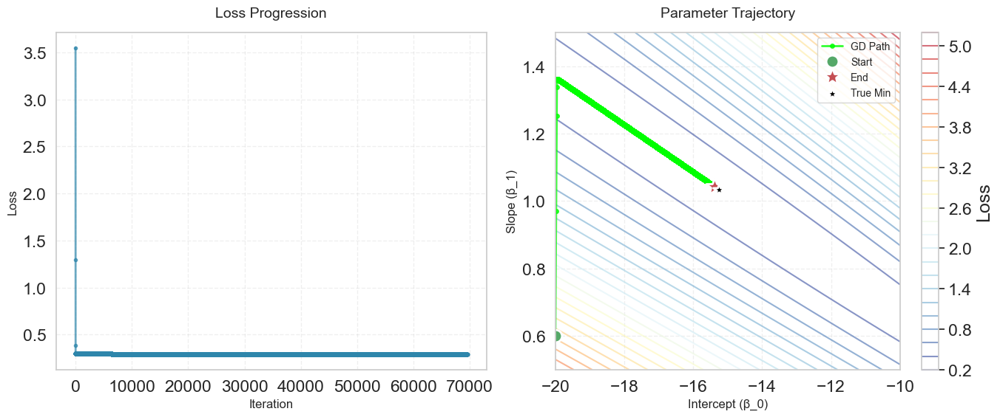

In [18]:
plot_gradient_descent_progress(
    losses=cancer_loss_history,
    params_history=cancer_parameter_history,
    param_names=["β_0", "β_1"],
    true_minimum=true_minimum_cancer,
    loss_contours=(cancer_beta_0_grid, cancer_beta_1_grid, cancer_losses_2d)
)

## Non-Convex Function Example

All the previous examples (linear regression with MSE and logistic regression with cross-entropy) have **convex** loss functions. 
This means they have a single global minimum, and gradient descent will find it regardless of where we start (given appropriate learning rate).

Now let's explore a **non-convex** function that has multiple local minima. This will demonstrate how gradient descent can converge to different solutions depending on the initial guess.

### A Simple Non-Convex Function

Consider the following polynomial function:

$$
f(\theta_0, \theta_1) = \theta_0^4 - 5\theta_0^2 + \theta_1^4 - 5\theta_1^2 + 0.1\theta_0 + 0.1\theta_1
$$

This function has multiple local minima. The quartic terms ($\theta^4$) create the overall structure, while the quadratic terms ($-5\theta^2$) create multiple valleys, and the linear terms provide slight asymmetry.

The gradients are straightforward to compute:

$$
\frac{\partial f}{\partial \theta_0} = 4\theta_0^3 - 10\theta_0 + 0.1
$$

$$
\frac{\partial f}{\partial \theta_1} = 4\theta_1^3 - 10\theta_1 + 0.1
$$

In [ ]:
def nonconvex_loss(
    X: np.ndarray,
    y: np.ndarray,
    betas: np.ndarray | list[float],
    normalized: bool = True,
) -> float:
    """Calculates a simple non-convex function with multiple local minima.

    This is a toy example, not a real loss function for a dataset.
    The X and y parameters are kept for consistency with other loss functions,
    but are not used in the calculation.

    Args:
        X: Unused, kept for API consistency.
        y: Unused, kept for API consistency.
        betas: The parameters [theta_0, theta_1].
        normalized: Unused, kept for API consistency.

    Returns:
        The function value at the given parameters.
    """
    if not isinstance(betas, np.ndarray):
        betas = np.array(betas).reshape(-1, 1)

    theta_0 = betas[0, 0]
    theta_1 = betas[1, 0]

    # f(theta_0, theta_1) = theta_0^4 - 5*theta_0^2 + theta_1^4 - 5*theta_1^2 + 0.1*theta_0 + 0.1*theta_1
    loss = (theta_0**4 - 5*theta_0**2 + theta_1**4 - 5*theta_1**2 +
            0.1*theta_0 + 0.1*theta_1)

    return loss


def nonconvex_loss_gradient(
    X: np.ndarray,
    y: np.ndarray,
    betas: np.ndarray | list[float],
    normalized: bool = True,
) -> np.ndarray:
    """Calculates the gradient of the non-convex function.

    Args:
        X: Unused, kept for API consistency.
        y: Unused, kept for API consistency.
        betas: The parameters [theta_0, theta_1].
        normalized: Unused, kept for API consistency.

    Returns:
        The gradient vector.
    """
    if not isinstance(betas, np.ndarray):
        betas = np.array(betas).reshape(-1, 1)

    theta_0 = betas[0, 0]
    theta_1 = betas[1, 0]

    # Partial derivatives
    grad_0 = 4*theta_0**3 - 10*theta_0 + 0.1
    grad_1 = 4*theta_1**3 - 10*theta_1 + 0.1

    grad = np.array([[grad_0], [grad_1]])

    return grad

In [22]:
# Create dummy X and y since our function doesn't use them
X_dummy = np.array([[1]])
y_dummy = np.array([[0]])

# Visualize the loss surface
theta_0_grid, theta_1_grid, nonconvex_losses_2d = plot_loss_surface_3d(
    X=X_dummy,
    y=y_dummy,
    loss_function=nonconvex_loss,
    param_ranges=((-3, 3), (-3, 3)),
    param_names=["θ_0", "θ_1"],
    true_minimum=None,  # Multiple minima exist!
    grid_size=150
)

Starting from (2.0, 2.0)...

Total number of iterations: 31
The final parameters are: [np.float64(1.57640523954374), np.float64(1.57640523954374)]


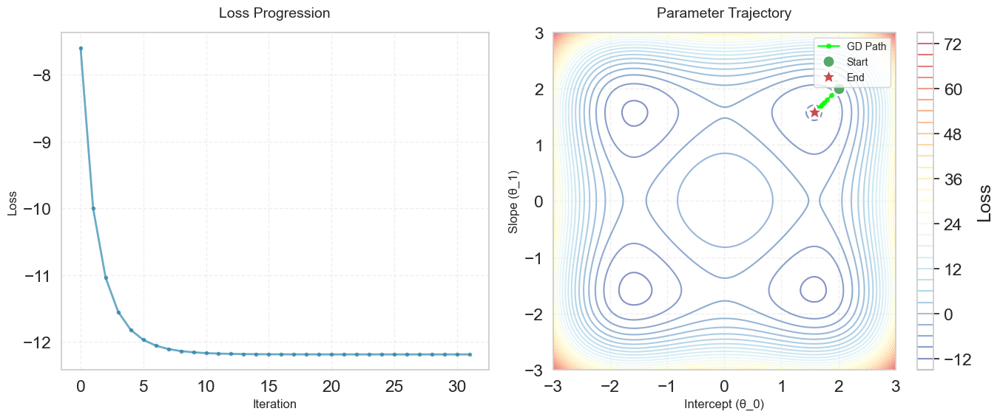

In [25]:
# Starting point 1: upper right
print("Starting from (2.0, 2.0)...")
params_history_1, loss_history_1 = gradient_descent(
    X=X_dummy,
    y=y_dummy,
    initial_guess=[2.0, 2.0],
    learning_rate=0.01,
    loss_function=nonconvex_loss,
    gradient_function=nonconvex_loss_gradient,
    threshold=1e-6,
)

# Visualize trajectory 1
plot_gradient_descent_progress(
    losses=loss_history_1,
    params_history=params_history_1,
    param_names=["θ_0", "θ_1"],
    true_minimum=None,
    loss_contours=(theta_0_grid, theta_1_grid, nonconvex_losses_2d)
)


Starting from (-2.0, -2.0)...

Total number of iterations: 31
The final parameters are: [np.float64(-1.58636291064884), np.float64(-1.58636291064884)]


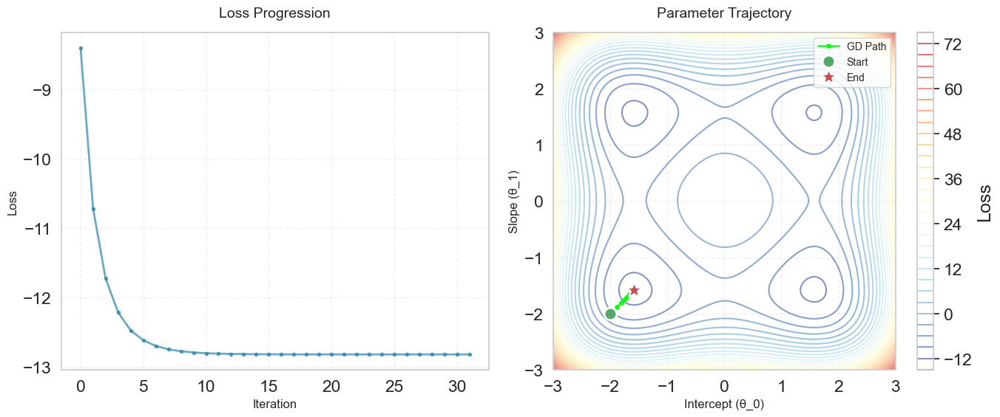

In [26]:
# Starting point 2: lower left
print("\nStarting from (-2.0, -2.0)...")
params_history_2, loss_history_2 = gradient_descent(
    X=X_dummy,
    y=y_dummy,
    initial_guess=[-2.0, -2.0],
    learning_rate=0.01,
    loss_function=nonconvex_loss,
    gradient_function=nonconvex_loss_gradient,
    threshold=1e-6,
)

# Visualize trajectory 2
plot_gradient_descent_progress(
    losses=loss_history_2,
    params_history=params_history_2,
    param_names=["θ_0", "θ_1"],
    true_minimum=None,
    loss_contours=(theta_0_grid, theta_1_grid, nonconvex_losses_2d)
)


Starting from (0.5, 0.5)...

Total number of iterations: 48
The final parameters are: [np.float64(1.5758472667850532), np.float64(1.5758472667850532)]


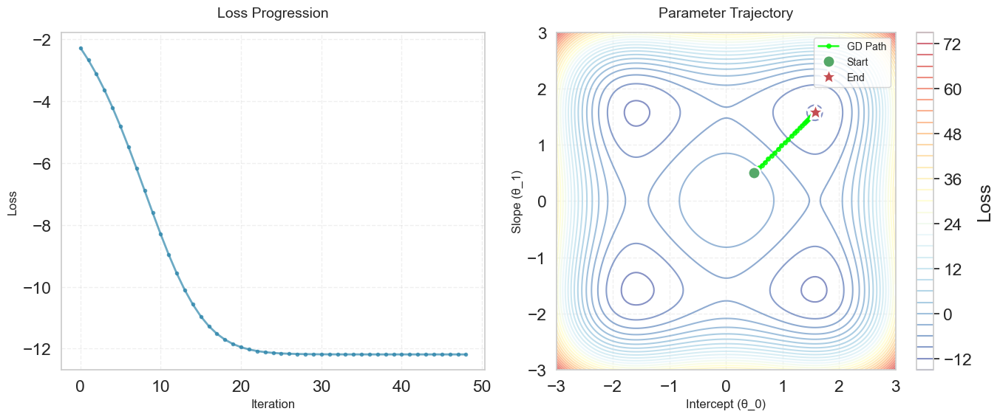

In [27]:
# Starting point 3: near origin
print("\nStarting from (0.5, 0.5)...")
params_history_3, loss_history_3 = gradient_descent(
    X=X_dummy,
    y=y_dummy,
    initial_guess=[0.5, 0.5],
    learning_rate=0.01,
    loss_function=nonconvex_loss,
    gradient_function=nonconvex_loss_gradient,
    threshold=1e-6,
)

# Visualize trajectory 3
plot_gradient_descent_progress(
    losses=loss_history_3,
    params_history=params_history_3,
    param_names=["θ_0", "θ_1"],
    true_minimum=None,
    loss_contours=(theta_0_grid, theta_1_grid, nonconvex_losses_2d)
)

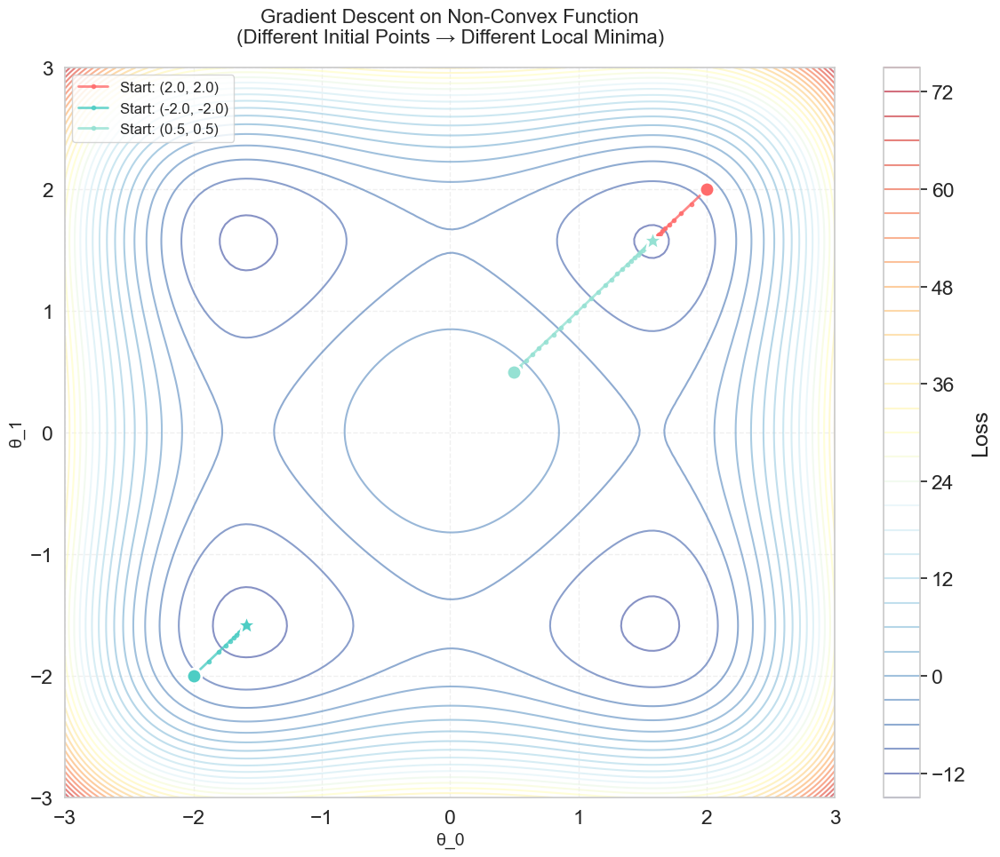


SUMMARY: Non-Convex Optimization
Final point from (2.0, 2.0):    θ = [np.float64(1.57640523954374), np.float64(1.57640523954374)], loss = -12.1843
Final point from (-2.0, -2.0):  θ = [np.float64(-1.58636291064884), np.float64(-1.58636291064884)], loss = -12.8167
Final point from (0.5, 0.5):    θ = [np.float64(1.5758472667850532), np.float64(1.5758472667850532)], loss = -12.1843

Notice how different starting points lead to different solutions!
This is the key challenge with non-convex optimization.


In [ ]:
# Create a comprehensive visualization showing all three paths together
fig, ax = plt.subplots(1, 1, figsize=(12, 10))

# Plot contours
contour = ax.contour(theta_0_grid, theta_1_grid, nonconvex_losses_2d, levels=30, cmap="RdYlBu_r", alpha=0.6)
plt.colorbar(contour, ax=ax, label="Loss")

# Plot trajectory 1
params_1 = np.array(params_history_1)
ax.plot(params_1[:, 0], params_1[:, 1], "o-", linewidth=2, markersize=3,
        color="#FF6B6B", alpha=0.8, label="Start: (2.0, 2.0)")
ax.plot(params_1[0, 0], params_1[0, 1], "o", markersize=12,
        markeredgecolor="white", markeredgewidth=2, color="#FF6B6B")
ax.plot(params_1[-1, 0], params_1[-1, 1], "*", markersize=18,
        markeredgecolor="white", markeredgewidth=2, color="#FF6B6B")

# Plot trajectory 2
params_2 = np.array(params_history_2)
ax.plot(params_2[:, 0], params_2[:, 1], "o-", linewidth=2, markersize=3,
        color="#4ECDC4", alpha=0.8, label="Start: (-2.0, -2.0)")
ax.plot(params_2[0, 0], params_2[0, 1], "o", markersize=12,
        markeredgecolor="white", markeredgewidth=2, color="#4ECDC4")
ax.plot(params_2[-1, 0], params_2[-1, 1], "*", markersize=18,
        markeredgecolor="white", markeredgewidth=2, color="#4ECDC4")

# Plot trajectory 3
params_3 = np.array(params_history_3)
ax.plot(params_3[:, 0], params_3[:, 1], "o-", linewidth=2, markersize=3,
        color="#95E1D3", alpha=0.8, label="Start: (0.5, 0.5)")
ax.plot(params_3[0, 0], params_3[0, 1], "o", markersize=12,
        markeredgecolor="white", markeredgewidth=2, color="#95E1D3")
ax.plot(params_3[-1, 0], params_3[-1, 1], "*", markersize=18,
        markeredgecolor="white", markeredgewidth=2, color="#95E1D3")

ax.set_xlabel("θ_0", fontsize=14)
ax.set_ylabel("θ_1", fontsize=14)
ax.set_title("Gradient Descent on Non-Convex Function\n(Different Initial Points → Different Local Minima)",
             fontsize=16, pad=20)
ax.legend(fontsize=12, loc="upper left")
ax.grid(True, alpha=0.3, linestyle="--")

plt.tight_layout()
plt.show()

print("\n" + "="*60)
print("SUMMARY: Non-Convex Optimization")
print("="*60)
print(f"Final point from (2.0, 2.0):    θ = {params_history_1[-1]}, loss = {loss_history_1[-1]:.4f}")
print(f"Final point from (-2.0, -2.0):  θ = {params_history_2[-1]}, loss = {loss_history_2[-1]:.4f}")
print(f"Final point from (0.5, 0.5):    θ = {params_history_3[-1]}, loss = {loss_history_3[-1]:.4f}")
print("\nNotice how different starting points lead to different solutions!")
print("This is the key challenge with non-convex optimization.")

## Gradient Descent with modern frameworks (PyTorch)

So far, we've manually implemented gradient descent by:
1. Defining the loss function
2. Defining the gradients (derivatives)
3. Writing our own update loop (algorithm)

In practice, modern machine learning uses frameworks like **PyTorch** or **TensorFlow** that:
- **Automatically compute gradients** (automatic differentiation)
- Provide **optimized optimizers** (SGD, Adam, etc.)
- Run computations efficiently on GPUs

Let's see how to implement the same examples using PyTorch. 

### Linear Regression with PyTorch

Let's reimplement our Auto MPG linear regression example using PyTorch. 

In [32]:
import torch
import torch.nn as nn
import torch.optim as optim

print(f"PyTorch version: {torch.__version__}")

# Convert our numpy data to PyTorch tensors
X_auto_torch = torch.from_numpy(X_auto).float()
y_auto_torch = torch.from_numpy(y_auto).float()

# Define a simple linear model
class LinearRegressionModel(nn.Module):
    def __init__(self):
        super(LinearRegressionModel, self).__init__()
        self.linear = nn.Linear(in_features=1, out_features=1, bias=True)

    def forward(self, x):
        """Forward pass through the model."""
        return self.linear(x)

# Initialize the model
model_auto = LinearRegressionModel()

# Define loss function (Mean Squared Error)
criterion = nn.MSELoss()

# Define optimizer (Stochastic Gradient Descent)
learning_rate = 1e-5
optimizer = optim.Adam(model_auto.parameters(), lr=1e-3)

# Prepare input (just horsepower, without the column of 1s)
X_auto_input = X_auto_torch[:, 1:2]  # Select only horsepower column

print("Initial parameters:")
print(f"  Intercept: {model_auto.linear.bias.item():.4f}")
print(f"  Slope: {model_auto.linear.weight.item():.4f}")

# Training loop
num_epochs = 50_000
loss_history_pytorch = []

for epoch in range(num_epochs):
    # Forward pass: compute predictions
    y_pred = model_auto(X_auto_input)

    # Compute loss
    loss = criterion(y_pred, y_auto_torch)
    loss_history_pytorch.append(loss.item())

    # Backward pass: compute gradients automatically!
    optimizer.zero_grad()  # Clear previous gradients
    loss.backward()  # Compute gradients via backpropagation

    # Update parameters
    optimizer.step()

    # Print progress
    if (epoch + 1) % 10000 == 0:
        print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}")

print("\nFinal parameters:")
print(f"  Intercept: {model_auto.linear.bias.item():.4f}")
print(f"  Slope: {model_auto.linear.weight.item():.4f}")

print("\nCompare with statsmodels result:")
print(f"  Intercept: {auto_result.params.iloc[0]:.4f}")
print(f"  Slope: {auto_result.params.iloc[1]:.4f}")

PyTorch version: 2.8.0
Initial parameters:
  Intercept: -0.8423
  Slope: 0.6056
Epoch [10000/50000], Loss: 154.8470
Epoch [20000/50000], Loss: 89.6144
Epoch [30000/50000], Loss: 47.2093
Epoch [40000/50000], Loss: 26.8588
Epoch [50000/50000], Loss: 23.9437

Final parameters:
  Intercept: 39.9357
  Slope: -0.1578

Compare with statsmodels result:
  Intercept: 39.9359
  Slope: -0.1578


### Logistic Regression with PyTorch

Now let's implement the breast cancer classification example using PyTorch.

In [ ]:
# Convert data to PyTorch tensors
X_cancer_torch = torch.from_numpy(X_cancer).float()
y_cancer_torch = torch.from_numpy(y_cancer).float()

# Define logistic regression model
class LogisticRegressionModel(nn.Module):
    def __init__(self):
        super(LogisticRegressionModel, self).__init__()
        self.linear = nn.Linear(in_features=1, out_features=1, bias=True)

    def forward(self, x):
        """Forward pass with sigmoid activation"""
        return torch.sigmoid(self.linear(x))

# Initialize model
model_cancer = LogisticRegressionModel()

# Define loss function (Binary Cross Entropy)
criterion_cancer = nn.BCELoss()

# Define optimizer
learning_rate_cancer = 1e-4
optimizer_cancer = optim.SGD(model_cancer.parameters(), lr=learning_rate_cancer)

# Prepare input (just radius_mean)
X_cancer_input = X_cancer_torch[:, 1:2]

print("Initial parameters:")
print(f"  Intercept (β_0): {model_cancer.linear.bias.item():.4f}")
print(f"  Slope (β_1): {model_cancer.linear.weight.item():.4f}")